# **Evaluation** 

In this last part we will explore the results of both models in numbers and plot their losses in order to have a better understanding of their performance

### The first model: SSD MobileNet_v2_320x320

In [ ]:
#eval mobilenet after 2k
%cd /content/drive/MyDrive/od/
!python model_main_tf2.py --model_dir=/content/drive/MyDrive/od/training_space/models_config/mobilenet --pipeline_config_path=/content/drive/MyDrive/od/training_space/models_config/mobilenet/pipeline.config --checkpoint_dir=/content/drive/MyDrive/od/training_space/models_config/mobilenet


/content/drive/MyDrive/od
/usr/local/lib/python3.10/dist-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(
W0502 13:30:01.587796 140424751478592 model_lib_v2.py:1089] Forced number of epochs for all eval validations to be 1.
INFO:tensorflow:Maybe overwriting sample_1_of_n_eval_examples: None
I0502 13:30:01.588025 140424751478592 config_util.py:552] Maybe overwriting sample_1_of_n_eval_examples: None
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I0502 13:30:01.588109 140424751478592 config_util.py:552] Maybe overwriting use_bfloat16: False
INFO:tensor

#### Testing the model on some images

Loading the model

In [ ]:
#switch to object detection folder to test the code
%cd /content/drive/MyDrive/od/

/content/drive/MyDrive/od


In [ ]:
"""
Object Detection (On Image) From TF2 Saved Model
=====================================
"""

import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'    # Suppress TensorFlow logging (1)
import pathlib
import tensorflow as tf
import cv2
import argparse
from google.colab.patches import cv2_imshow

# Enable GPU dynamic memory allocation
gpus = tf.config.experimental.list_physical_devices('GPU')
for gpu in gpus:
    tf.config.experimental.set_memory_growth(gpu, True)


# PROVIDE PATH TO MODEL DIRECTORY
PATH_TO_MODEL_DIR = '/content/drive/MyDrive/od/training_space/exported_model/exported_mobilenet'

# PROVIDE PATH TO LABEL MAP
PATH_TO_LABELS = '/content/drive/MyDrive/od/training_space/annotations/label_map.pbtxt'

# PROVIDE THE MINIMUM CONFIDENCE THRESHOLD
MIN_CONF_THRESH = float(0.60)

# LOAD THE MODEL

import time
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils

PATH_TO_SAVED_MODEL = PATH_TO_MODEL_DIR + "/saved_model"

print('Loading model...', end='')
start_time = time.time()

# LOAD SAVED MODEL AND BUILD DETECTION FUNCTION
detect_fn = tf.saved_model.load(PATH_TO_SAVED_MODEL)

end_time = time.time()
elapsed_time = end_time - start_time
print('Done! Took {} seconds'.format(elapsed_time))

# LOAD LABEL MAP DATA FOR PLOTTING

category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS,
                                                                    use_display_name=True)


Loading model...Done! Took 9.623900175094604 seconds


storing images in a list

In [ ]:
import pathlib
import glob
IMAGE_PATHS=[]

for filename in glob.glob('/content/drive/MyDrive/od/images/test/*.png'):
    IMAGE_PATHS.append(filename)

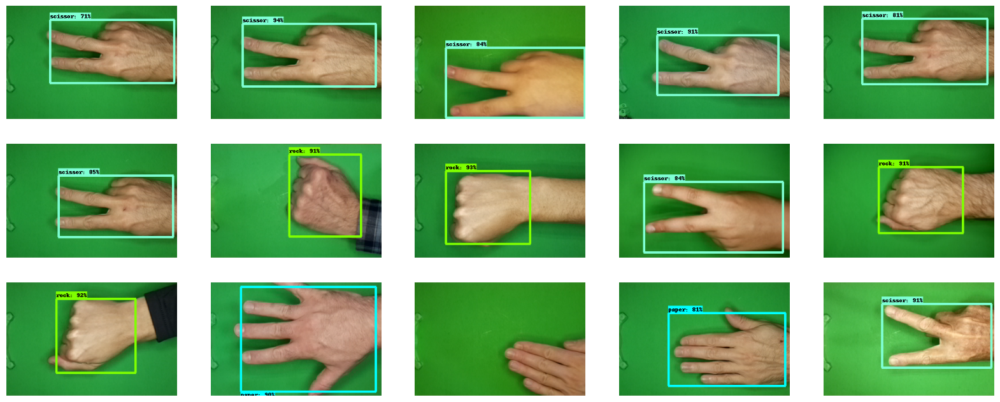

In [ ]:
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import warnings
from imutils.object_detection import non_max_suppression
warnings.filterwarnings('ignore')   # Suppress Matplotlib warnings
%matplotlib inline

def load_image_into_numpy_array(path):
    """Load an image from file into a numpy array.

    Puts image into numpy array to feed into tensorflow graph.
    Note that by convention we put it into a numpy array with shape
    (height, width, channels), where channels=3 for RGB.

    Args:
      path: the file path to the image

    Returns:
      uint8 numpy array with shape (img_height, img_width, 3)
    """
    return np.array(Image.open(path))

fig = plt.figure(figsize=(20, 8))

for num, image_path in enumerate (IMAGE_PATHS):

    # print('Running inference for {}... '.format(image_path), end='')

    image_np = load_image_into_numpy_array(image_path)

    # Things to try:
    # Flip horizontally
    # image_np = np.fliplr(image_np).copy()

    # Convert image to grayscale
    # image_np = np.tile(
    #     np.mean(image_np, 2, keepdims=True), (1, 1, 3)).astype(np.uint8)

    # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
    input_tensor = tf.convert_to_tensor(image_np)
    # The model expects a batch of images, so add an axis with `tf.newaxis`.
    input_tensor = input_tensor[tf.newaxis, ...]

    # input_tensor = np.expand_dims(image_np, 0)
    detections = detect_fn(input_tensor)

    # All outputs are batches tensors.
    # Convert to numpy arrays, and take index [0] to remove the batch dimension.
    # We're only interested in the first num_detections.
    num_detections = int(detections.pop('num_detections'))
    detections = {key: value[0, :num_detections].numpy()
                   for key, value in detections.items()}
    detections['num_detections'] = num_detections
    # detection_classes should be ints.
    detections['detection_classes'] = detections['detection_classes'].astype(np.int64)
  
    image_np_with_detections = image_np.copy()

    viz_utils.visualize_boxes_and_labels_on_image_array(
          image_np_with_detections,
          detections['detection_boxes'],
          detections['detection_classes'],
          detections['detection_scores'],
          category_index,
          use_normalized_coordinates=True,
          max_boxes_to_draw=100,
          min_score_thresh=.7,
          agnostic_mode=False)

    fig.add_subplot(3, 5, num+1)
    # plt.title(image_path.split('.')[0])
    plt.axis('off')
    plt.imshow(image_np_with_detections)
    # print('Done')
plt.show()


#### **TensorBoard**

Getting a final total loss = **1.298**

In [ ]:
%load_ext tensorboard
%tensorboard --logdir /content/drive/MyDrive/od/training_space/models_config/mobilenet/train

<IPython.core.display.Javascript object>

Getting mean Average Percision = **0.7618**

In [ ]:
%load_ext tensorboard
%tensorboard --logdir /content/drive/MyDrive/od/training_space/models_config/mobilenet/eval --port=6007

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

### The Second model: Efficientdet_d0_coco17_tpu_32

#### Testing the model on some images

Loading the model

In [ ]:
#switch to object detection folder to test the code
%cd /content/drive/MyDrive/od/

/content/drive/MyDrive/od


In [ ]:
"""
Object Detection (On Image) From TF2 Saved Model
=====================================
"""

import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'    # Suppress TensorFlow logging (1)
import pathlib
import tensorflow as tf
import cv2
import argparse
from google.colab.patches import cv2_imshow

# Enable GPU dynamic memory allocation
gpus = tf.config.experimental.list_physical_devices('GPU')
for gpu in gpus:
    tf.config.experimental.set_memory_growth(gpu, True)


# PROVIDE PATH TO MODEL DIRECTORY
PATH_TO_MODEL_DIR = '/content/drive/MyDrive/od/training_space/exported_model/exported_efficientdet_d0_coco17_tpu_32'

# PROVIDE PATH TO LABEL MAP
PATH_TO_LABELS = '/content/drive/MyDrive/od/training_space/annotations/label_map.pbtxt'

# PROVIDE THE MINIMUM CONFIDENCE THRESHOLD
MIN_CONF_THRESH = float(0.60)

# LOAD THE MODEL

import time
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils

PATH_TO_SAVED_MODEL = PATH_TO_MODEL_DIR + "/saved_model"

print('Loading model...', end='')
start_time = time.time()

# LOAD SAVED MODEL AND BUILD DETECTION FUNCTION
detect_fn2 = tf.saved_model.load(PATH_TO_SAVED_MODEL)

end_time = time.time()
elapsed_time = end_time - start_time
print('Done! Took {} seconds'.format(elapsed_time))

# LOAD LABEL MAP DATA FOR PLOTTING

category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS,
                                                                    use_display_name=True)


Loading model...Done! Took 23.596516609191895 seconds


storing images in a list

In [ ]:
import pathlib
import glob
IMAGE_PATHS=[]

for filename in glob.glob('/content/drive/MyDrive/od/images/test/*.png'):
    IMAGE_PATHS.append(filename)

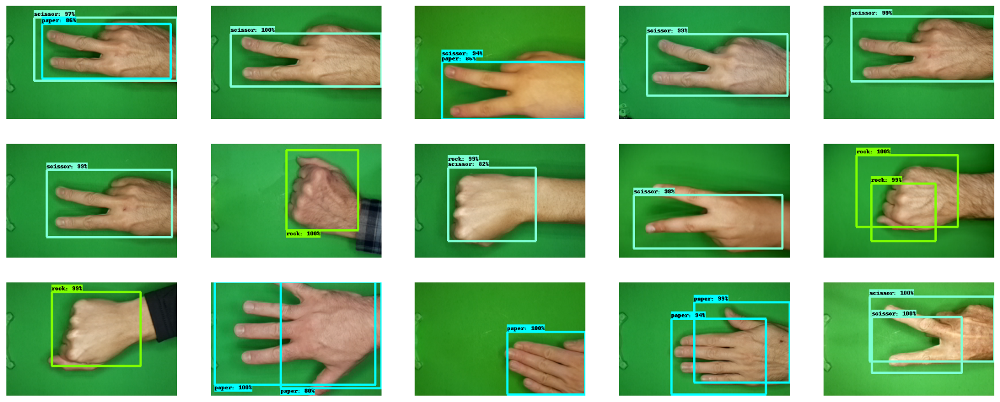

In [ ]:
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import warnings
from imutils.object_detection import non_max_suppression
warnings.filterwarnings('ignore')   # Suppress Matplotlib warnings
%matplotlib inline

def load_image_into_numpy_array(path):
    """Load an image from file into a numpy array.

    Puts image into numpy array to feed into tensorflow graph.
    Note that by convention we put it into a numpy array with shape
    (height, width, channels), where channels=3 for RGB.

    Args:
      path: the file path to the image

    Returns:
      uint8 numpy array with shape (img_height, img_width, 3)
    """
    return np.array(Image.open(path))

fig = plt.figure(figsize=(20, 8))

for num, image_path in enumerate (IMAGE_PATHS):

    # print('Running inference for {}... '.format(image_path), end='')

    image_np = load_image_into_numpy_array(image_path)

    # Things to try:
    # Flip horizontally
    # image_np = np.fliplr(image_np).copy()

    # Convert image to grayscale
    # image_np = np.tile(
    #     np.mean(image_np, 2, keepdims=True), (1, 1, 3)).astype(np.uint8)

    # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
    input_tensor = tf.convert_to_tensor(image_np)
    # The model expects a batch of images, so add an axis with `tf.newaxis`.
    input_tensor = input_tensor[tf.newaxis, ...]

    # input_tensor = np.expand_dims(image_np, 0)
    detections = detect_fn2(input_tensor)

    # All outputs are batches tensors.
    # Convert to numpy arrays, and take index [0] to remove the batch dimension.
    # We're only interested in the first num_detections.
    num_detections = int(detections.pop('num_detections'))
    detections = {key: value[0, :num_detections].numpy()
                   for key, value in detections.items()}
    detections['num_detections'] = num_detections
    # detection_classes should be ints.
    detections['detection_classes'] = detections['detection_classes'].astype(np.int64)
  
    image_np_with_detections = image_np.copy()

    viz_utils.visualize_boxes_and_labels_on_image_array(
          image_np_with_detections,
          detections['detection_boxes'],
          detections['detection_classes'],
          detections['detection_scores'],
          category_index,
          use_normalized_coordinates=True,
          max_boxes_to_draw=10,
          min_score_thresh=.7,
          agnostic_mode=False)

    fig.add_subplot(3, 5, num+1)
    # plt.title(image_path.split('.')[0])
    plt.axis('off')
    plt.imshow(image_np_with_detections)
    # print('Done')
plt.show()


#### **TensorBoard**

Getting a final total loss = **0.1215**

In [ ]:
%load_ext tensorboard
%tensorboard --logdir /content/drive/MyDrive/od/training_space/models_config/efficientdet_d0_coco17_tpu_32/train --port=6008

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

Getting mean Average Percision = **0.7317**

In [ ]:
%load_ext tensorboard
%tensorboard --logdir /content/drive/MyDrive/od/training_space/models_config/efficientdet_d0_coco17_tpu_32/eval --port=6009

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

**SSD_MobileNet**

Total loss  = **0.083**

mean Average Percision = **0.7618**

**Efficientdet_d0_coco17_tpu_32**

Total loss = **0.1215**

mean Average Percision = **0.7317**

Wecan conclude that **SSD_MobileNet** performs better

# Summary

**SSD_MobileNet**

Total loss  = **1.298**

mean Average Percision = **0.7618**

**Efficientdet_d0_coco17_tpu_32**

Total loss = **0.1215**

mean Average Percision = **0.7317**

Wecan conclude that **SSD_MobileNet** performs better